# Pix2Pix Head Rotation with Symmetry and Identity Preserving Loss
Code adapted from:
  - [Pix2Pix Tensor flow docs](https://github.com/tensorflow/docs/blob/master/site/en/tutorials/generative/pix2pix.ipynb).
  - [LightCNN Keras implementation](https://github.com/yh-iro/Keras_LightCNN)
  - [TP-GAN official implementation](https://github.com/HRLTY/TP-GAN)
  - [TP-GAN Keras implementation](https://github.com/yh-iro/Keras_TP-GAN)

In [1]:
from __future__ import absolute_import, division, print_function, unicode_literals

try:
  %tensorflow_version 2.x
except Exception:
  pass
import tensorflow as tf

import os
import time
import numpy as np

from matplotlib import pyplot as plt
from IPython import display

from tensorflow.keras.layers import Conv2D, Conv2DTranspose, BatchNormalization, Activation, \
LeakyReLU, Input, Flatten, Dense, Maximum, Lambda, Concatenate, Reshape, Add, MaxPooling2D, \
AveragePooling2D, Dropout, Average
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.initializers import Zeros, TruncatedNormal, RandomNormal, Constant
from tensorflow.keras.models import Model, Sequential
import tensorflow.keras.regularizers as regularizers

## Load the dataset

In [2]:
PATH = 'data/'

In [3]:
BUFFER_SIZE = 400
BATCH_SIZE = 1
IMG_WIDTH = 128
IMG_HEIGHT = 128

In [4]:
def load(image_file):
    image = tf.io.read_file(image_file)
    image = tf.image.decode_png(image, channels=3)

    real_image = image[0:128, 0:128, :]
    real_image = tf.cast(real_image, tf.float32)
    
    input_image = image[0:128, 128:256, :]
    input_image = tf.cast(input_image, tf.float32)

    return input_image, real_image

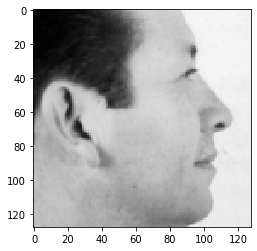

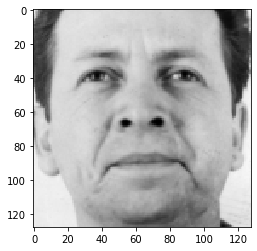

In [5]:
inp, re = load(PATH+'train/00001_1.png')
plt.figure()
plt.imshow(inp/255)
plt.figure()
plt.imshow(re/255)

In [6]:
# normalizing the images to [-1, 1]
def normalize(input_image, real_image):
    input_image = (input_image / 127.5) - 1
    real_image = (real_image / 127.5) - 1

    return input_image, real_image

In [7]:
def load_image(image_file):
  input_image, real_image = load(image_file)
  input_image, real_image = normalize(input_image, real_image)

  return input_image, real_image

## Input Pipeline

In [8]:
train_dataset = tf.data.Dataset.list_files(PATH+'train/*.png')
train_dataset = train_dataset.map(load_image,
                                  num_parallel_calls=tf.data.experimental.AUTOTUNE)
train_dataset = train_dataset.shuffle(BUFFER_SIZE)
train_dataset = train_dataset.batch(BATCH_SIZE)

In [9]:
test_dataset = tf.data.Dataset.list_files(PATH+'test/*.png')
test_dataset = test_dataset.map(load_image)
test_dataset = test_dataset.batch(BATCH_SIZE)

### Light-CNN
Code taken directly from [LightCNN Keras implementation](https://github.com/yh-iro/Keras_LightCNN).

In [10]:
class LightCNN():

    def __init__(self, classes=None, extractor_type='29v2', extractor_weights=None, classifier_weights=None, in_size_hw=(128, 128)):
        """
        initialize light cnn network with given weights file. if weights file is None, the weights are initialized by default initializer.
        
        Args:
            classes (int): number of output classes. required when training or using classifier. not required when using only exractor.
            extractor_type (str): string of network type. must be one of the following strings "29v2", "29", "9".
            extractor_weights (str): trained extractor weights file path. it is used to resume training. not required when train from scratch.
            classifier_weights (str): trained classifier weights file path. it is used to resume training. not required when training from scratch or only using extractor.
            in_size_hw (tuple): height and width of input image. 
        """

        self.in_size_hw = in_size_hw
        self.num_classes = classes
        self.extractor_weights = extractor_weights
        self.classifier_weights = classifier_weights
        self._extractor = None
        self._classifier = None
        
        # if extractor_weights is not None, attempt to resume current epoch number from file name.
        if self.extractor_weights is not None:
            try:
                self.current_epochs = int(re.match(r'.+[_h]([0-9]+)\.hdf5', self.extractor_weights).groups()[0])
            except:
                print('trained epochs was not found in extractor_weights_file name. use 0 as current_epochs.')
                self.current_epochs = 0
        else:
            self.current_epochs = 0
            
        self.extractor_type = extractor_type
            
        
    def extractor(self):
        """
        getter for singleton extractor.
        """
        
        if self._extractor is None:
            if self.extractor_type == '29v2':
                self._extractor = self.build_extractor_29layers_v2(name='extract29v2', block=self._res_block, layers=[1, 2, 3, 4])
            elif self.extractor_type == '29':
                self._extractor = self.build_extractor_29layers(name='extract29', block=self._res_block, layers=[1, 2, 3, 4])
            elif self.extractor_type == '9':
                self._extractor = self.build_extractor_9layers(name='extract9')
        
            if self.extractor_weights is not None:
                self._extractor.load_weights(self.extractor_weights)
                
        return self._extractor
    
    def classifier(self):
        """
        getter for singleton classifier.
        """
        
        if self._classifier is None:
            self._classifier = self.build_classifier(name='classify')
            
        if self.classifier_weights is not None:
            self._classifier.load_weights(self.classifier_weights)
        
        return self._classifier
    
    
    def _mfm(self, X, name, out_channels, kernel_size=3, strides=1, dense=False):
        """
        private func for creating mfm layer.
        
        Todo:
            * maybe more natural if implemented as custom layer like the comment out code at the bottom of this file.
        """
        
        if dense:
            X = Dense(out_channels*2, name = name + '_dense1', kernel_regularizer=regularizers.l2(0.0005))(X)
        else:
            X = Conv2D(out_channels*2, name = name + '_conv2d1', kernel_size=kernel_size, kernel_regularizer=regularizers.l2(0.0005), strides=strides, padding='same')(X)
            
        X = Maximum()([Lambda(lambda x, c: x[..., :c], arguments={'c':out_channels})(X), Lambda(lambda x, c: x[..., c:], arguments={'c':out_channels})(X)])
        
        return X
    
    def _group(self, X, name, in_channels, out_channels, kernel_size, strides):
        
        X = self._mfm(X, name = name + '_mfm1', out_channels=in_channels, kernel_size=1, strides=1, dense=False)
        X = self._mfm(X, name = name + '_mfm2', out_channels=out_channels, kernel_size=kernel_size, strides=strides)
        
        return X
    
    def _res_block(self, X, name, out_channels):
        """
        private func for creating residual block with mfm layers.
        """
        
        X_shortcut = X
        X = self._mfm(X, name = name + '_mfm1', out_channels=out_channels, kernel_size=3, strides=1)
        X = self._mfm(X, name = name + '_mfm2', out_channels=out_channels, kernel_size=3, strides=1)
        X = Add()([X, X_shortcut])
        return X
    
    def _make_layer(self, X, name, block, num_blocks, out_channels):
        """
        private func for creating multiple blocks. block is usualy res_block.
        """
        
        for i in range(0, num_blocks):
            X = block(X, name = name + '_block{}'.format(i), out_channels=out_channels)
        return X

    def build_extractor_9layers(self, name):
        
        in_img = Input(shape=(*self.in_size_hw, 1))
        
        X = self._mfm(in_img, name = name + '_mfm1', out_channels=48, kernel_size=5, strides=1)
        X = MaxPooling2D(pool_size=2, padding='same')(X)
        X = self._group(X, name = name + '_group1', in_channels=48, out_channels=96, kernel_size=3, strides=1)
        X = MaxPooling2D(pool_size=2, padding='same')(X)        
        X = self._group(X, name = name + '_group2', in_channels=96, out_channels=192, kernel_size=3, strides=1)
        X = MaxPooling2D(pool_size=2, padding='same')(X) 
        X = self._group(X, name = name + '_group3', in_channels=192, out_channels=128, kernel_size=3, strides=1)
        X = self._group(X, name = name + '_group4', in_channels=128, out_channels=128, kernel_size=3, strides=1)
        feat_map = MaxPooling2D(pool_size=2, padding='same')(X)       
        feat_vec = Dense(256, name = name + '_dense1', kernel_regularizer=regularizers.l2(0.0005))(Flatten()(X))

        ret_extractor = Model(inputs=in_img, outputs=[feat_vec, feat_map], name=name)
        ret_extractor.summary()
        
        return ret_extractor
    
    def build_extractor_29layers(self, name, block, layers):
        
        in_img = Input(shape=(*self.in_size_hw, 1))
        
        X = self._mfm(in_img, name = name + '_mfm1', out_channels=48, kernel_size=5, strides=1)
        X = MaxPooling2D(pool_size=2, padding='same')(X)
        X = self._make_layer(X, name = name + '_layers1', block=block, num_blocks=layers[0], out_channels=48)
        X = self._group(X, name = name + '_group1', in_channels=48, out_channels=96, kernel_size=3, strides=1)
        X = MaxPooling2D(pool_size=2, padding='same')(X)
        X = self._make_layer(X, name = name + '_layers2', block=block, num_blocks=layers[1], out_channels=96)
        X = self._group(X, name = name + '_group2', in_channels=96, out_channels=192, kernel_size=3, strides=1)
        X = MaxPooling2D(pool_size=2, padding='same')(X)
        X = self._make_layer(X, name = name + '_layers3', block=block, num_blocks=layers[2], out_channels=192)
        X = self._group(X, name = name + '_group3', in_channels=192, out_channels=128, kernel_size=3, strides=1)
        X = self._make_layer(X, name = name + '_layers4', block=block, num_blocks=layers[3], out_channels=128)
        X = self._group(X, name = name + '_group4', in_channels=128, out_channels=128, kernel_size=3, strides=1)
        feat_map = MaxPooling2D(pool_size=2, padding='same')(X)
        feat_vec = self._mfm(Flatten()(feat_map), name = name + '_mfm2', out_channels=256, dense=True)

        ret_extractor = Model(inputs=in_img, outputs=[feat_vec, feat_map], name=name)
        ret_extractor.summary()
        
        return ret_extractor
                    
    def build_extractor_29layers_v2(self, name, block, layers):
        
        in_img = Input(shape=(*self.in_size_hw, 1))
        
        X = self._mfm(in_img, name = name + '_mfm1', out_channels=48, kernel_size=5, strides=1)
        X = Average()([MaxPooling2D(pool_size=2, padding='same')(X), AveragePooling2D(pool_size=2, padding='same')(X)])
        X = self._make_layer(X, name = name + '_layers1', block=block, num_blocks=layers[0], out_channels=48)
        X = self._group(X, name = name + '_group1', in_channels=48, out_channels=96, kernel_size=3, strides=1)
        X = Average()([MaxPooling2D(pool_size=2, padding='same')(X), AveragePooling2D(pool_size=2, padding='same')(X)])
        X = self._make_layer(X, name = name + '_layers2', block=block, num_blocks=layers[1], out_channels=96)
        X = self._group(X, name = name + '_group2', in_channels=96, out_channels=192, kernel_size=3, strides=1)
        X = Average()([MaxPooling2D(pool_size=2, padding='same')(X), AveragePooling2D(pool_size=2, padding='same')(X)])
        X = self._make_layer(X, name = name + '_layers3', block=block, num_blocks=layers[2], out_channels=192)
        X = self._group(X, name = name + '_group3', in_channels=192, out_channels=128, kernel_size=3, strides=1)
        X = self._make_layer(X, name = name + '_layers4', block=block, num_blocks=layers[3], out_channels=128)
        X = self._group(X, name = name + '_group4', in_channels=128, out_channels=128, kernel_size=3, strides=1)
        feat_map = Average()([MaxPooling2D(pool_size=2, padding='same')(X), AveragePooling2D(pool_size=2, padding='same')(X)])
        feat_vec = Dense(256, name = name + '_dense1', kernel_regularizer=regularizers.l2(0.0005))(Flatten()(feat_map))
        
        ret_extractor = Model(inputs=in_img, outputs=[feat_vec, feat_map], name=name)        
        ret_extractor.summary()
        
        return ret_extractor
    
    def build_classifier(self, name):
        
        in_feat = Input(shape=(256,))
        X = Dropout(0.7)(in_feat)
               
        X = Dense(500, activation='relu', name = name + '_dense1', kernel_regularizer=regularizers.l2(0.005))(X)
        X = Dropout(0.7)(X)
    
        clas = Dense(self.num_classes, activation='softmax', name = name + '_dense2', use_bias=False , kernel_regularizer=regularizers.l2(0.005))(X)
        
        ret_classifier = Model(inputs=in_feat, outputs=clas, name=name)
        
        ret_classifier.summary()
        return ret_classifier
        

    def train(self, train_gen, valid_gen=None, optimizer=SGD(lr=0.001, momentum=0.9, decay=0.00004, nesterov=True),
              classifier_dropout=0.7, steps_per_epoch=100, validation_steps=100,
              epochs=1, out_dir='../out/', out_period=1, fix_extractor=False):
        """
        train extractor and classifier.
        
        Args:
            train_gen (generator): train data generator provided by celeb_gen.
            valid_gen (generator): valid data generator provided by celeb_gen.
            optimizer (Optimizer): keras optimizer used to train.
            classifier_dropout (float): dropout ratio for training classifier.
            steps_per_epoch (int): steps for each epoch. 
            validation_steps (int): steps for validation on the end of each epoch.
            epochs (int): epochs to train.
            out_prefix (str): prefix str for output weights file.
            out_period (int): interval epochs for output weights file.
            fix_extractor (bool): if true, train only classifier. if false, train both extractor and classifier.
        """        
        
        self.classifier().trainable = True
        self.extractor().trainable = not fix_extractor           
        
        for layer in self.classifier().layers:
            if type(layer) == Dropout:
                layer.rate = classifier_dropout
        
        train_model = Sequential([Model(inputs=self.extractor().inputs, outputs=self.extractor().outputs[0]), self.classifier()])
        train_model.summary()
        
        train_model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['acc'])
        
        if out_dir != '':
            tf.gfile.MakeDirs(out_dir)
        
        history = train_model.fit_generator(train_gen, steps_per_epoch=steps_per_epoch, epochs=epochs+self.current_epochs, workers=0, validation_data=valid_gen, validation_steps=validation_steps, initial_epoch=self.current_epochs)
        self.current_epochs += epochs
                    
        return history
    
    def evaluate(self, generator, steps=100):
        
        train_model = Sequential([Model(inputs=self.extractor().inputs, outputs=self.extractor().outputs[0]), self.classifier()])
        train_model.summary()
        
        train_model.compile(optimizer='SGD', loss='categorical_crossentropy', metrics=['acc'])

        score = train_model.evaluate_generator(generator, steps=steps)
                    
        return {'loss':score[0], 'acc':score[1]}
    
    def predict_class(self, gray_img_batch):
        feat = self.extractor().predict(gray_img_batch)
        clas = self.classifier().predict(feat)
        return np.argmax(clas, axis=-1)
    
    def exract_features(self, gray_img_batch):
        feat = self.extractor().predict(gray_img_batch)
        return feat

Load pre-trained LightCNN weights. Available [here](https://drive.google.com/drive/folders/1hBAEbDTpzEXbdFCWXueq-5MWGCSb7sMK).

In [11]:
# Load light-cnn pre-trained weights
lcnn = LightCNN(extractor_type='29v2', extractor_weights='light-cnn/extract29v2_lr0.00010_loss0.997_valacc1.000_epoch1110.hdf5')
lcnn.extractor().trainable = False

trained epochs was not found in extractor_weights_file name. use 0 as current_epochs.
Model: "extract29v2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 128, 128, 1) 0                                            
__________________________________________________________________________________________________
extract29v2_mfm1_conv2d1 (Conv2 (None, 128, 128, 96) 2496        input_1[0][0]                    
__________________________________________________________________________________________________
lambda (Lambda)                 (None, 128, 128, 48) 0           extract29v2_mfm1_conv2d1[0][0]   
__________________________________________________________________________________________________
lambda_1 (Lambda)               (None, 128, 128, 48) 0           extract29v2_mfm1_conv2d1[0][0]   
__

## Build the Generator

In [12]:
OUTPUT_CHANNELS = 3

In [13]:
def downsample(filters, size, apply_batchnorm=True):
    initializer = tf.random_normal_initializer(0., 0.02)

    result = tf.keras.Sequential()
    result.add(
        tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                               kernel_initializer=initializer, use_bias=False))

    if apply_batchnorm:
        result.add(tf.keras.layers.BatchNormalization())

    result.add(tf.keras.layers.LeakyReLU())

    return result

In [14]:
def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)

    result = tf.keras.Sequential()
    result.add(
        tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                        padding='same',
                                        kernel_initializer=initializer,
                                        use_bias=False))

    result.add(tf.keras.layers.BatchNormalization())

    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))

    result.add(tf.keras.layers.ReLU())

    return result

In [15]:
def Generator():
    inputs = tf.keras.layers.Input(shape=[128,128,3])

    down_stack = [
        downsample(64, 4, apply_batchnorm=False), # (bs, 64, 64, 64)
        downsample(128, 4), # (bs, 32, 32, 128)
        downsample(256, 4), # (bs, 16, 16, 256)
        downsample(512, 4), # (bs, 8, 8, 512)
        downsample(512, 4), # (bs, 4, 4, 512)
        downsample(512, 4), # (bs, 2, 2, 512)
        downsample(512, 4), # (bs, 1, 1, 512)
    ]

    up_stack = [
        upsample(512, 4, apply_dropout=True), # (bs, 2, 2, 512)
        upsample(512, 4, apply_dropout=True), # (bs, 4, 4, 512)
        upsample(512, 4), # (bs, 8, 8, 512)
        upsample(256, 4), # (bs, 16, 16, 256)
        upsample(128, 4), # (bs, 32, 32, 128)
        upsample(64, 4), # (bs, 64, 64, 64)
    ]

    initializer = tf.random_normal_initializer(0., 0.02)
    last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 4,
                                           strides=2,
                                           padding='same',
                                           kernel_initializer=initializer,
                                           activation='tanh') # (bs, 128, 128, 3)

    x = inputs

    # Downsampling through the model
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)

    skips = reversed(skips[:-1])

    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = tf.keras.layers.Concatenate()([x, skip])

    x = last(x)

    return tf.keras.Model(inputs=inputs, outputs=x)

In [16]:
generator = Generator()
generator.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 128, 128, 3) 0                                            
__________________________________________________________________________________________________
sequential (Sequential)         (None, 64, 64, 64)   3072        input_2[0][0]                    
__________________________________________________________________________________________________
sequential_1 (Sequential)       (None, 32, 32, 128)  131584      sequential[1][0]                 
__________________________________________________________________________________________________
sequential_2 (Sequential)       (None, 16, 16, 256)  525312      sequential_1[1][0]               
______________________________________________________________________________________________

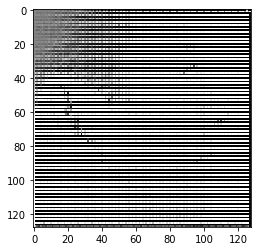

In [17]:
gen_output = generator(inp[tf.newaxis,...], training=False)
plt.imshow(gen_output[0,...][:, :, 0], cmap='gray')

### Generator loss

In [18]:
def generator_loss(disc_generated_output, gen_output, target):
    gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

    # mean absolute error
    l1_loss = tf.reduce_mean(tf.abs(target - gen_output))
    
    # identity-preserving loss
    vec_true, map_true = lcnn.extractor()(tf.image.rgb_to_grayscale(target * 0.5 + 0.5))
    vec_pred, map_pred = lcnn.extractor()(tf.image.rgb_to_grayscale(gen_output * 0.5 + 0.5))
    ip_loss = tf.reduce_mean(tf.abs(vec_pred - vec_true)) + tf.reduce_mean(tf.abs(map_pred - map_true))
    
    # symmetry loss
    sym_loss = tf.reduce_mean(tf.abs(gen_output[:,:,::-1,:] - gen_output))
    
    total_gen_loss = (1 * gan_loss) + (50 * l1_loss) + (1 * ip_loss) + (1 * sym_loss)

    return total_gen_loss, gan_loss, l1_loss, ip_loss, sym_loss

## Build the Discriminator

In [19]:
def Discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)

    inp = tf.keras.layers.Input(shape=[128, 128, 3], name='input_image')
    tar = tf.keras.layers.Input(shape=[128, 128, 3], name='target_image')

    x = tf.keras.layers.concatenate([inp, tar]) # (bs, 128, 128, channels*2)

    down1 = downsample(64, 4, False)(x) # (bs, 64, 64, 64)
    down2 = downsample(128, 4)(down1) # (bs, 32, 32, 128)

    zero_pad1 = tf.keras.layers.ZeroPadding2D()(down2) # (bs, 18, 18, 256)
    conv = tf.keras.layers.Conv2D(512, 4, strides=1,
                                  kernel_initializer=initializer,
                                  use_bias=False)(zero_pad1) # (bs, 15, 15, 512)

    batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

    leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

    zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu) # (bs, 17, 17, 512)

    last = tf.keras.layers.Conv2D(1, 4, strides=1,
                                  kernel_initializer=initializer)(zero_pad2) # (bs, 14, 14, 1)

    return tf.keras.Model(inputs=[inp, tar], outputs=last)

In [20]:
discriminator = Discriminator()
discriminator.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_image (InputLayer)        [(None, 128, 128, 3) 0                                            
__________________________________________________________________________________________________
target_image (InputLayer)       [(None, 128, 128, 3) 0                                            
__________________________________________________________________________________________________
concatenate_6 (Concatenate)     (None, 128, 128, 6)  0           input_image[0][0]                
                                                                 target_image[0][0]               
__________________________________________________________________________________________________
sequential_13 (Sequential)      (None, 64, 64, 64)   6144        concatenate_6[0][0]        

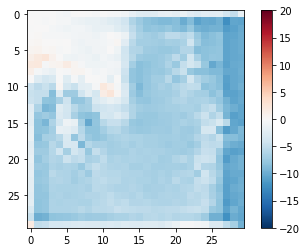

In [21]:
disc_out = discriminator([inp[tf.newaxis,...], gen_output], training=False)
plt.imshow(disc_out[0,...,-1], vmin=-20, vmax=20, cmap='RdBu_r')
plt.colorbar()

In [22]:
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [23]:
def discriminator_loss(disc_real_output, disc_generated_output):
    real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)
    generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)
    total_disc_loss = real_loss + generated_loss

    return total_disc_loss

## Define the Optimizers and Checkpoint-saver




In [24]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [25]:
checkpoint_dir = 'checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

## Generate Images

In [26]:
def generate_images(model, test_input, tar):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(8,8))

  display_list = [test_input[0], tar[0], prediction[0]]
  title = ['Input Image', 'Ground Truth', 'Predicted Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    plt.imshow((display_list[i] * 0.5 + 0.5)[:,:,0], cmap='gray')
    plt.axis('off')
  plt.show()

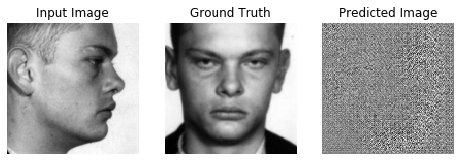

In [27]:
for example_input, example_target in test_dataset.take(1):
  generate_images(generator, example_input, example_target)

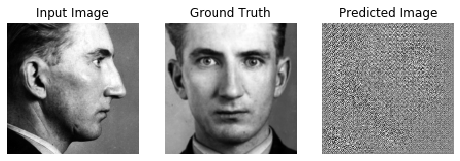

In [28]:
BASELINE_IMG = PATH+'test/00596_1.png'
baseline_dataset = tf.data.Dataset.list_files(BASELINE_IMG)
baseline_dataset = baseline_dataset.map(load_image)
baseline_dataset = baseline_dataset.batch(BATCH_SIZE)
for iin, itar in baseline_dataset.take(1):
  baseline_in = iin
  baseline_tar = itar
generate_images(generator, baseline_in, baseline_tar)

In [29]:
def baseline_image(model, test_input, tar, epoch):
    baseline_dir = 'baselines'
    if not os.path.isdir(baseline_dir):
        os.makedirs(baseline_dir)

    img_name = baseline_dir + '/epoch_%d.png' % epoch
    prediction = model(test_input, training=True)
    plt.figure(figsize=(8,4))

    display_list = [test_input[0], tar[0], prediction[0]]
    title = ['Input Image', 'Ground Truth', 'Predicted Image']

    for i in range(3):
        ax = plt.subplot(1, 3, i+1)
        plt.title(title[i])
        plt.imshow((display_list[i] * 0.5 + 0.5)[:,:,0], cmap='gray')
        #ax.imshow((display_list[i] * 0.5 + 0.5)[:,:,0], cmap='gray')
        plt.axis('off')
    plt.savefig(img_name, bbox_inches='tight')
    plt.clf() 
    plt.close()
    return img_name

## Training

In [30]:
EPOCHS = 200

In [31]:
import datetime
log_dir="logs/"

summary_writer = tf.summary.create_file_writer(
  log_dir + "fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

In [32]:
@tf.function(input_signature=[tf.TensorSpec(shape=(None, 128, 128, 3), dtype=tf.float32),
                             tf.TensorSpec(shape=(None, 128, 128, 3), dtype=tf.float32),
                             tf.TensorSpec(shape=(), dtype=tf.int64)])
def train_step(input_image, target, epoch):
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    gen_output = generator(input_image, training=True)

    disc_real_output = discriminator([input_image, target], training=True)
    disc_generated_output = discriminator([input_image, gen_output], training=True)

    gen_total_loss, gen_gan_loss, gen_l1_loss, ip_loss, sym_loss = generator_loss(disc_generated_output, gen_output, target)
    disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

  generator_gradients = gen_tape.gradient(gen_total_loss,
                                          generator.trainable_variables)
  discriminator_gradients = disc_tape.gradient(disc_loss,
                                               discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(generator_gradients,
                                          generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(discriminator_gradients,
                                              discriminator.trainable_variables))

  with summary_writer.as_default():
    tf.summary.scalar('gen_total_loss', gen_total_loss, step=epoch)
    tf.summary.scalar('gen_gan_loss', gen_gan_loss, step=epoch)
    tf.summary.scalar('gen_l1_loss', gen_l1_loss, step=epoch)
    tf.summary.scalar('ip_loss', ip_loss, step=epoch)
    tf.summary.scalar('sym_loss', sym_loss, step=epoch)
    tf.summary.scalar('disc_loss', disc_loss, step=epoch)

In [33]:
def fit(train_ds, epochs, test_ds):
  for epoch in range(epochs):
    start = time.time()

    baseline_file = baseline_image(generator, baseline_in, baseline_tar, epoch)
    raw_img = tf.io.read_file(baseline_file)
    baseline_img = tf.image.decode_png(raw_img, channels=1)
    with summary_writer.as_default():
      tf.summary.image("Test Baseline", np.reshape(baseline_img,(-1, baseline_img.shape[0],
                                                                 baseline_img.shape[1], baseline_img.shape[2])), step=epoch)

    print("Epoch: ", epoch)

    # Train
    for n, (input_image, target) in train_ds.enumerate():
      print('.', end='')
      if (n+1) % 100 == 0:
        print()
      train_step(input_image, target, epoch)
    print()

    # saving (checkpoint) the model every 40 epochs
    if (epoch + 1) % 40 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)
    
    display.clear_output(wait=True)

    print ('Time taken for epoch {} is {} sec\n'.format(epoch,
                                                        time.time()-start))
  checkpoint.save(file_prefix = checkpoint_prefix)

In [ ]:
%load_ext tensorboard
%tensorboard --logdir {log_dir}

In [ ]:
start = time.time()
fit(train_dataset, EPOCHS, test_dataset)
end = time.time()
print("Training time: %f hours" % ((end - start) / 60 / 60))

## Restore the latest checkpoint

In [34]:
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

## Generate using test dataset

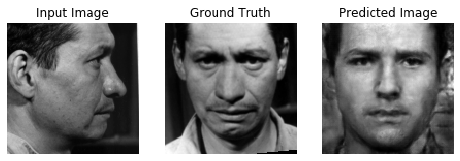

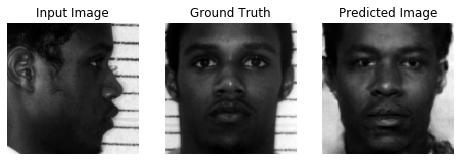

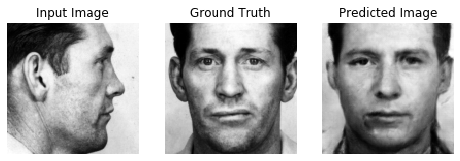

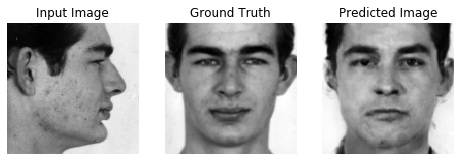

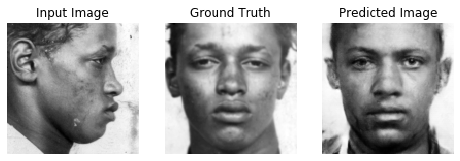

In [35]:
for inp, tar in test_dataset.take(5):
  generate_images(generator, inp, tar)